# Task: As a business manager, 
- perform EDA

 - y to find out the weak areas where you can work to make more profit.

 - at all business problems you can derive by exploring the data?

# Importing the Libraries

In [31]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt

# Importing the Dataset

In [32]:
dataset = pd.read_csv('SampleSuperstore.csv')

# Looking at the dataset

In [33]:
dataset.head()

,Ship Mode,Segment,Country,City,State,Postal Code,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Bookcases,261.9600,2,0.00,41.9136
1,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Chairs,731.9400,3,0.00,219.5820
2,Second Class,Corporate,United States,Los Angeles,California,90036,West,Office Supplies,Labels,14.6200,2,0.00,6.8714
3,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Furniture,Tables,957.5775,5,0.45,-383.0310
4,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Office Supplies,Storage,22.3680,2,0.20,2.5164


In [34]:
dataset.tail()

,Ship Mode,Segment,Country,City,State,Postal Code,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
9989,Second Class,Consumer,United States,Miami,Florida,33180,South,Furniture,Furnishings,25.248,3,0.2,4.1028
9990,Standard Class,Consumer,United States,Costa Mesa,California,92627,West,Furniture,Furnishings,91.960,2,0.0,15.6332
9991,Standard Class,Consumer,United States,Costa Mesa,California,92627,West,Technology,Phones,258.576,2,0.2,19.3932
9992,Standard Class,Consumer,United States,Costa Mesa,California,92627,West,Office Supplies,Paper,29.600,4,0.0,13.3200
9993,Second Class,Consumer,United States,Westminster,California,92683,West,Office Supplies,Appliances,243.160,2,0.0,72.9480


In [35]:
dataset.shape

(9994, 13)

In [36]:
dataset.describe()

,Postal Code,Sales,Quantity,Discount,Profit
count,9994.000000,9994.000000,9994.000000,9994.000000,9994.000000
mean,55190.379428,229.858001,3.789574,0.156203,28.656896
std,32063.693350,623.245101,2.225110,0.206452,234.260108
min,1040.000000,0.444000,1.000000,0.000000,-6599.978000
25%,23223.000000,17.280000,2.000000,0.000000,1.728750
50%,56430.500000,54.490000,3.000000,0.200000,8.666500
75%,90008.000000,209.940000,5.000000,0.200000,29.364000
max,99301.000000,22638.480000,14.000000,0.800000,8399.976000


`Here Postal Code, although a numeric value, doesn't provide benefit for exploration `

In [37]:
dataset.columns

Index(['Ship Mode', 'Segment', 'Country', 'City', 'State', 'Postal Code',
       'Region', 'Category', 'Sub-Category', 'Sales', 'Quantity', 'Discount',
       'Profit'],
      dtype='object')

### We will see number of unique values for each column 

In [38]:
dataset.nunique()

Ship Mode          4
Segment            3
Country            1
City             531
State             49
Postal Code      631
Region             4
Category           3
Sub-Category      17
Sales           5825
Quantity          14
Discount          12
Profit          7287
dtype: int64

` Important Columns are `
- ` State `
- ` Ship Mode `
- ` Segment `
- ` Region `
- ` Category `
- ` Sales `
- ` Quantity `
- ` Discount `
- ` Profit `


In [40]:
dataset['Region'].unique()

array(['South', 'West', 'Central', 'East'], dtype=object)

In [41]:
dataset['Category'].unique()

array(['Furniture', 'Office Supplies', 'Technology'], dtype=object)

In [42]:
dataset['Segment'].unique()

array(['Consumer', 'Corporate', 'Home Office'], dtype=object)

In [45]:
dataset['Ship Mode'].unique()

array(['Second Class', 'Standard Class', 'First Class', 'Same Day'],
      dtype=object)

# Cleaning the Data

### Checking for null values

In [47]:
dataset.isnull().sum()

Ship Mode       0
Segment         0
Country         0
City            0
State           0
Postal Code     0
Region          0
Category        0
Sub-Category    0
Sales           0
Quantity        0
Discount        0
Profit          0
dtype: int64

` There are no null values `

### Removing Unnecessary Columns

Important columns are
- State
- Ship Mode
- Segment
- Region
- Category
- Sales
- Quantity
- Discount
- Profit

In [54]:
retail = dataset.drop(['Country', 'City', 'Postal Code'], axis = 1)

In [55]:
retail.head()

,Ship Mode,Segment,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,Second Class,Consumer,Kentucky,South,Furniture,Bookcases,261.9600,2,0.00,41.9136
1,Second Class,Consumer,Kentucky,South,Furniture,Chairs,731.9400,3,0.00,219.5820
2,Second Class,Corporate,California,West,Office Supplies,Labels,14.6200,2,0.00,6.8714
3,Standard Class,Consumer,Florida,South,Furniture,Tables,957.5775,5,0.45,-383.0310
4,Standard Class,Consumer,Florida,South,Office Supplies,Storage,22.3680,2,0.20,2.5164


# Relationship Analysis

In [59]:
correlation = retail.corr()

### Plotting a Heat Map

<AxesSubplot:>

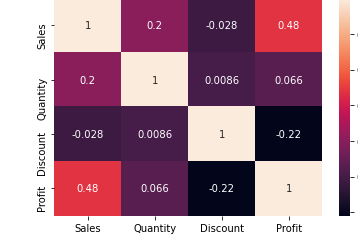

In [60]:
sns.heatmap(corelation, xticklabels= correlation.columns, yticklabels=correlation.columns, annot= True)

### Plotting Pair Plot 

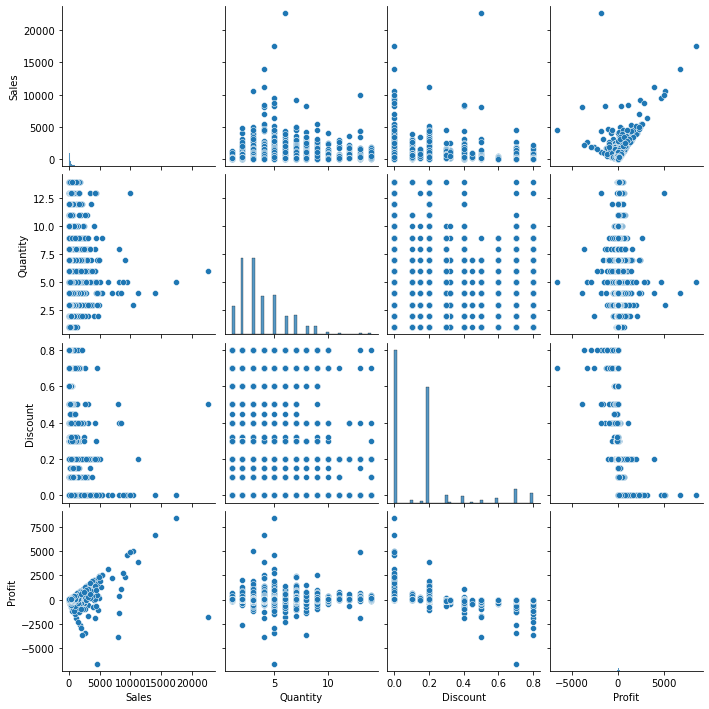

In [58]:
sns.pairplot(retail)

` Some inferences `
- More sales deosn't necessary mean more profit, most profit is had at range 0 to 10k sales
- Most Losses are incurred at deals where sales were between 0 to 5k
- Business harvests more profit if discounts are less, more discounts lead to losses
- Profit and Quantity of item don't necessarily have correlation 
- Quantity of item sold is evenly distributed in relation to amount of discount

### Plotting Scatter Plots

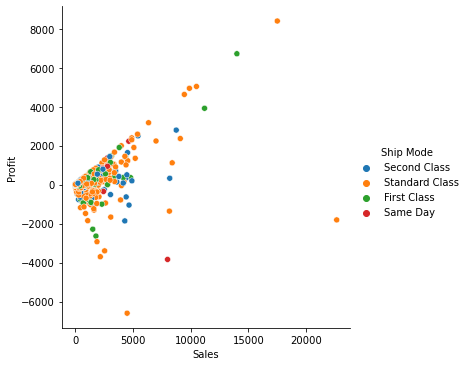

In [61]:
sns.relplot(x = 'Sales', y = 'Profit', hue = 'Ship Mode', data = retail)

` Some inferences `
- Second Class Ship Mode gives more profits and has generally more sales use this mode
- First Class Gives less losses but only for limited number of sales
- Majority of sales use Standard Mode

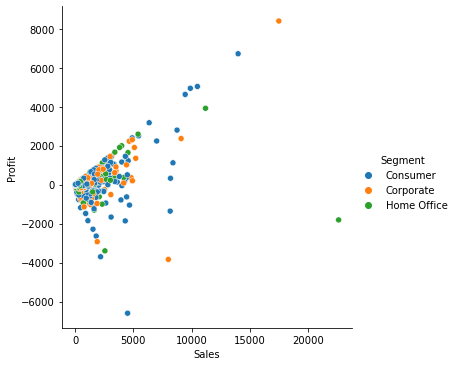

In [62]:
sns.relplot(x = 'Sales', y = 'Profit', hue = 'Segment', data = retail)

` Some inferences `
- Consumers comprise the most sales and higher consumer sales give the most profit consistently
- Corporate sales are generally profitable

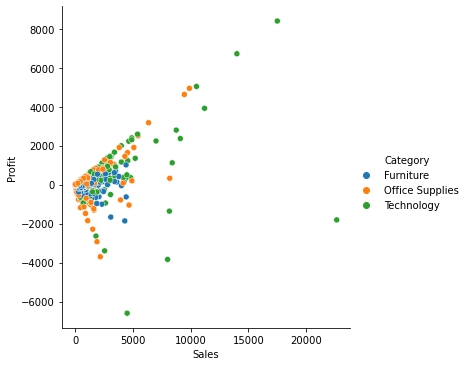

In [63]:
sns.relplot(x = 'Sales', y = 'Profit', hue = 'Category', data = retail)

` Some inferences `
- Technological item category is very profitable consistently
- Furniture sales are generally in smaller number

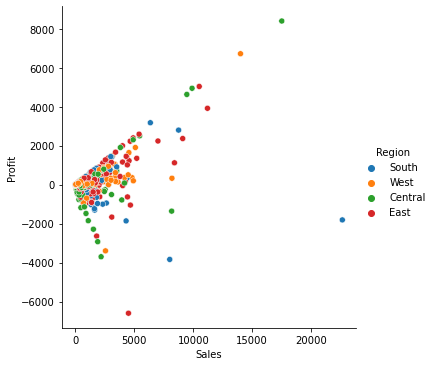

In [66]:
sns.relplot(x = 'Sales', y = 'Profit', hue = 'Region', data = retail)

` Some inferences `
- Business in South region incurres many losses
- West region sales give a profit over small number of sales
- East region gives large profits for large sales
- Business in Central region incurres many losses for small number of sales

### Plotting Histograms

C:\Python\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Sales', ylabel='Density'>

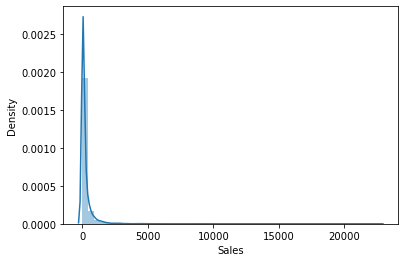

In [67]:
sns.distplot(retail['Sales'])

C:\Python\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Profit', ylabel='Density'>

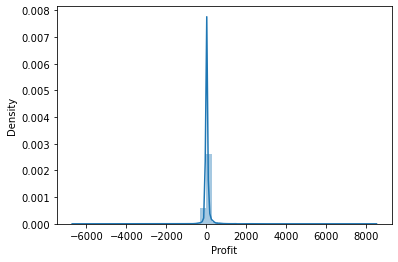

In [68]:
sns.distplot(retail['Profit'])

C:\Python\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Discount', ylabel='Density'>

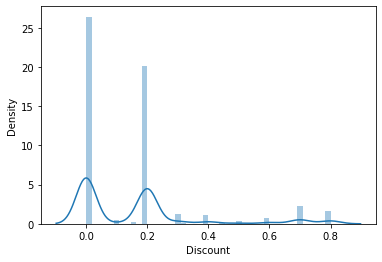

In [69]:
sns.distplot(retail['Discount'])

C:\Python\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Quantity', ylabel='Density'>

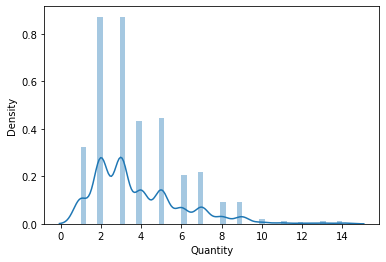

In [70]:
sns.distplot(retail['Quantity'])